In [1]:
import torch
import torch.nn as nn
import torch.nn.functional as F
from torchvision import datasets, transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import mlflow
from mlflow.models.signature import infer_signature
from tqdm import tqdm

from src.torch_utilities import *

from IPython.display import HTML
import matplotlib.animation as animation

In [2]:
mlflow.set_tracking_uri('http://localhost:5000')

In [3]:
transform = transforms.Compose([transforms.ToTensor(),
                              ])

device = 'cuda:0' if torch.cuda.is_available() else 'cpu'
device = torch.device(device)

!mkdir data
batch_size = 64

trainset = datasets.MNIST('data', download=True, train=True, transform=transform)
valset = datasets.MNIST('data', download=True, train=False, transform=transform)
trainloader = torch.utils.data.DataLoader(trainset, batch_size=batch_size, shuffle=True)
valloader = torch.utils.data.DataLoader(valset, batch_size=batch_size, shuffle=True)

A subdirectory or file data already exists.


In [4]:
class Generator(nn.Module):
    def __init__(self,
                 latent_dim: int = 100,
                 dropout: float = 0.2
                 ):
        super().__init__()
        
        self.latent_dim = latent_dim
        self.dropout = dropout
        
        self.sequence = nn.Sequential(
            # Linear
            nn.Linear(latent_dim, 128),
            nn.GELU(),
            nn.Dropout(dropout),
            nn.Linear(128, 3 * 3 * 32),
            nn.GELU(),
            nn.Dropout(dropout),
            # Reshape
            nn.Unflatten(1, (32, 3, 3)),
            # Convolve
            nn.ConvTranspose2d(32, 16, 3, stride=2, output_padding=0),
            nn.BatchNorm2d(16),
            nn.GELU(),
            nn.Dropout(dropout),
            nn.ConvTranspose2d(16, 8, 3, stride=2, padding=1, output_padding=1),
            nn.BatchNorm2d(8),
            nn.GELU(),
            nn.Dropout(dropout),
            nn.ConvTranspose2d(8, 1, 3, stride=2, padding=1, output_padding=1),
            nn.Sigmoid()
        )
        
    def forward(self, x):
        return self.sequence(x)
    
class Discriminator(nn.Module):
    def __init__(self):
        super().__init__()
        self.sequence = nn.Sequential(
            nn.Flatten(),
            nn.Linear(28*28, 512),
            nn.ReLU(),
            nn.Linear(512, 256),
            nn.ReLU(),
            nn.Linear(256, 1),
            nn.Sigmoid()
        )
        
    def forward(self, x):
        return self.sequence(x)

In [5]:
latent_dim = 100
dropout = 0.5

fixed_noise = torch.randn(64, latent_dim, device=device)

real_label = 1.
fake_label = 0.

generator = Generator(latent_dim=latent_dim, dropout=dropout).to(device)
discriminator = Discriminator().to(device)

loss_fn = nn.BCELoss()

lr = 1e-3
g_optim = torch.optim.Adam(generator.parameters(), lr=lr)
d_optim = torch.optim.Adam(discriminator.parameters(), lr=lr)

n_epochs = 40

img_list = []
G_losses = []
D_losses = []
G_batch_losses = []
D_batch_losses = []
iters = 0

for epoch in range(1, n_epochs + 1):
    for i, (real, _) in enumerate(trainloader):
        ## train the discriminator on real data
        # make the discriminator predict on the real data
        real = real.to(device)
        b_size = real.size(0)
        label = torch.full((b_size,), real_label, dtype=torch.float, device=device)
        output = discriminator(real).view(-1)
        
        # calculate the loss
        d_loss_real = loss_fn(output, label)
        
        ## train the discriminator on fake data
        # generate fake data
        noise = torch.randn(b_size, latent_dim, device=device)
        fake = generator(noise)
        label = label.clone().fill_(fake_label)
        
        # make the discriminator predict on the fake data
        output = discriminator(fake.detach()).view(-1)
        
        # calculate the loss
        d_loss_fake = loss_fn(output, label)
 
        # compute full loss and backpropagate       
        d_loss = d_loss_real + d_loss_fake
        d_optim.zero_grad()
        d_loss.backward()
        d_optim.step()
        
        
        ## train the generator
        label.fill_(real_label)
        
        # make the discriminator predict on the fake data
        output = discriminator(fake).view(-1)
        
        # calculate the loss for the generator
        g_loss = loss_fn(output, label)
        
        # backpropagate
        g_optim.zero_grad()
        g_loss.backward()
        g_optim.step()
        
        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f'
                  % (epoch, n_epochs, i, len(trainloader),
                     d_loss.item(), g_loss.item()))

        # Save Losses for plotting later
        G_losses.append(g_loss.item())
        D_losses.append(d_loss.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == n_epochs-1) and (i == len(trainloader)-1)):
            with torch.no_grad():
                fake = generator(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1
        
    G_batch_losses.append(np.mean(G_losses[-b_size:]))
    D_batch_losses.append(np.mean(D_losses[-b_size:]))

[1/40][0/938]	Loss_D: 1.3960	Loss_G: 1.1268
[1/40][50/938]	Loss_D: 0.0001	Loss_G: 19.1934
[1/40][100/938]	Loss_D: 0.0005	Loss_G: 22.1743
[1/40][150/938]	Loss_D: 0.0003	Loss_G: 14.4525
[1/40][200/938]	Loss_D: 0.0042	Loss_G: 14.2085
[1/40][250/938]	Loss_D: 0.0141	Loss_G: 13.9218
[1/40][300/938]	Loss_D: 0.0005	Loss_G: 11.1434
[1/40][350/938]	Loss_D: 0.0004	Loss_G: 10.2083
[1/40][400/938]	Loss_D: 0.0001	Loss_G: 10.0705
[1/40][450/938]	Loss_D: 0.0003	Loss_G: 8.4641
[1/40][500/938]	Loss_D: 0.0006	Loss_G: 8.4229
[1/40][550/938]	Loss_D: 0.0005	Loss_G: 8.3686
[1/40][600/938]	Loss_D: 0.0004	Loss_G: 8.4873
[1/40][650/938]	Loss_D: 0.0004	Loss_G: 8.4341
[1/40][700/938]	Loss_D: 0.0005	Loss_G: 8.4615
[1/40][750/938]	Loss_D: 0.0011	Loss_G: 8.9082
[1/40][800/938]	Loss_D: 0.0006	Loss_G: 8.9499
[1/40][850/938]	Loss_D: 0.0008	Loss_G: 8.0962
[1/40][900/938]	Loss_D: 0.0002	Loss_G: 10.3202
[2/40][0/938]	Loss_D: 0.0050	Loss_G: 9.5845
[2/40][50/938]	Loss_D: 0.2727	Loss_G: 10.4019
[2/40][100/938]	Loss_D: 0.0130

C:\Users\marcu\AppData\Local\Temp\ipykernel_19672\2176610364.py:24: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


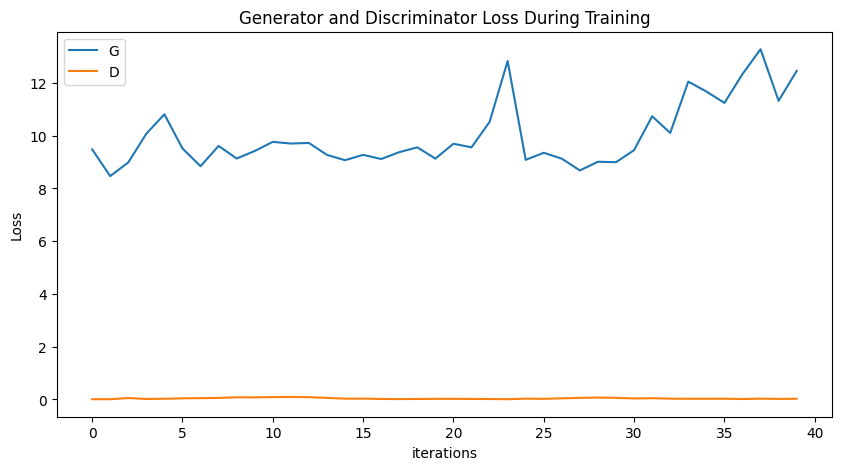

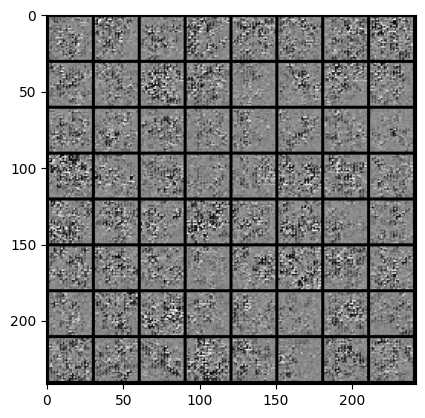

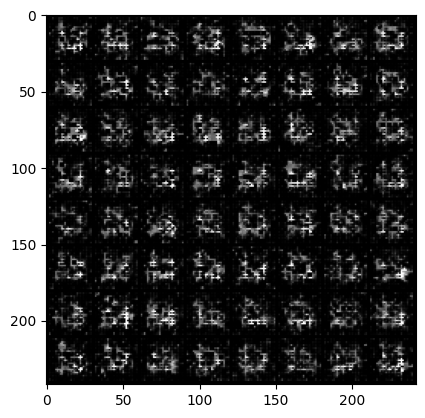

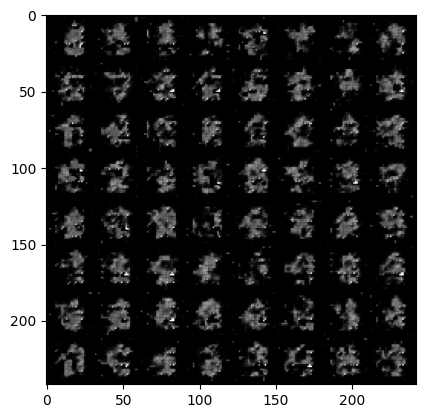

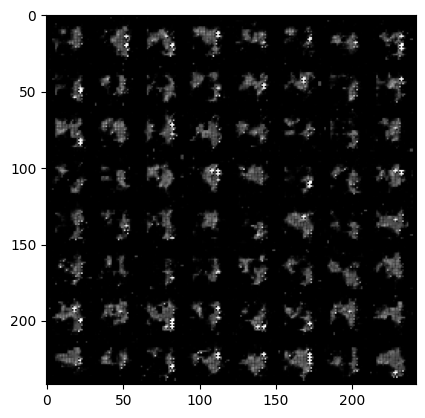

...

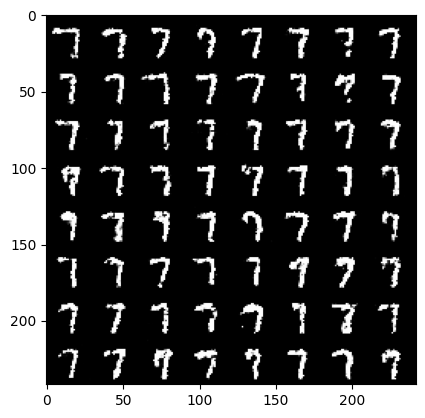

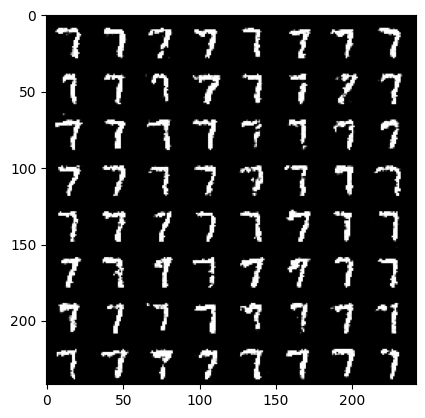

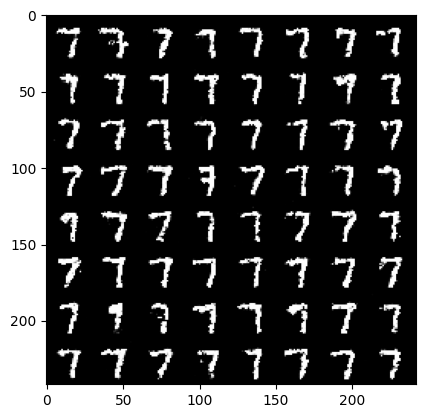

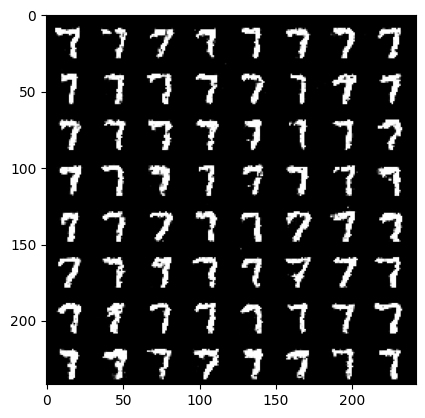

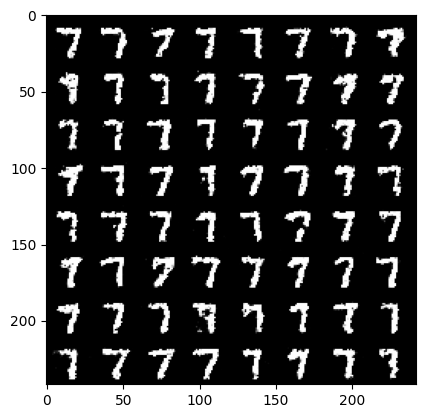

In [6]:
with mlflow.start_run():
    params = {
        'n_epochs': n_epochs,
        'lr': lr,
        'latent_dim': latent_dim,
        'batch_size': batch_size,
        'optimizer': 'Adam',
        'loss_fn': 'BCELoss'
    }

    mlflow.log_params(params)
    
    metrics = {
        'g_final_loss': G_batch_losses[-1],
        'd_final_loss': D_batch_losses[-1]
    }
    
    mlflow.log_metrics(metrics)
    
    fig, ax = plot_gan_loss(G_batch_losses, D_batch_losses, show=False)
    mlflow.log_figure(fig, 'gan_loss.svg')
    
    for i, img in enumerate(img_list):
        fig, ax = plt.subplots()
        ax.imshow(np.transpose(img,(1,2,0)), animated=True)
        mlflow.log_figure(fig, f'training_{i}.svg')
    

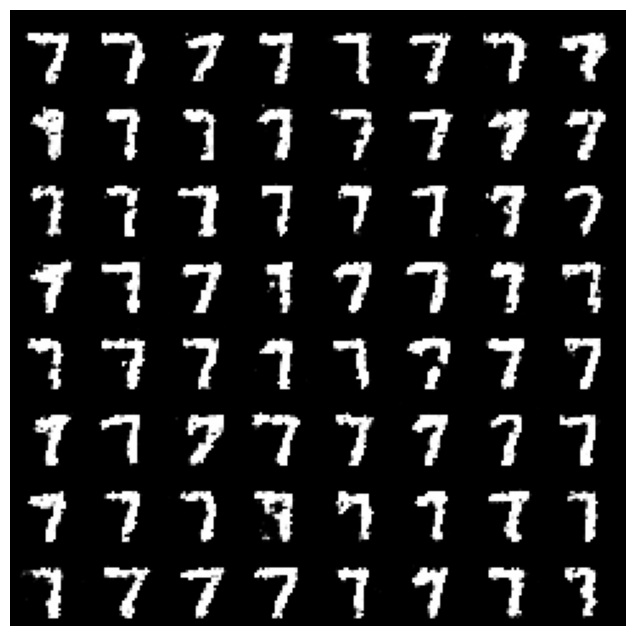

In [10]:
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())